In [1]:
import scanpy as sc
import scvelo as scv
import anndata as ad
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os

# Load data

In [2]:
scvelo_adata = scv.read("data/scvelo.h5ad")
celldancer_adata = scv.read("data/celldancer.h5ad")
deepvelo_adata = scv.read("data/deepvelo.h5ad")
julovelo_adata = scv.read("data/JuloVelo.h5ad")

In [3]:
celldancer_adata.uns["clusters_colors"] = scvelo_adata.uns["clusters_colors"]
julovelo_adata.uns["clusters_colors"] = scvelo_adata.uns["clusters_colors"]

In [4]:
celldancer_adata.obs.clusters = pd.Categorical(celldancer_adata.obs.clusters, categories=['Ductal', 'Ngn3 low EP', 'Ngn3 high EP', 'Pre-endocrine', 'Beta', 'Alpha', 'Delta', 'Epsilon'], ordered=False)
julovelo_adata.obs.clusters = pd.Categorical(julovelo_adata.obs.clusters, categories=['Ductal', 'Ngn3 low EP', 'Ngn3 high EP', 'Pre-endocrine', 'Beta', 'Alpha', 'Delta', 'Epsilon'], ordered=False)

# Plot function

In [5]:
def plotting_sort(adata, layer1, layer2, n_convolve, col_color, save = False, save_path = ""):
    gene = adata.var_names
    var_names = [name for name in gene if name in adata.var_names]
    
    time = adata.obs["pseudotime"].values
    time = time[np.isfinite(time)]
    
    X1 = (
        adata[:, var_names].layers[layer1]
        if layer1 in adata.layers.keys()
        else adata[:, var_names].X
    )
    
    X2 = (
        adata[:, var_names].layers[layer2]
        if layer2 in adata.layers.keys()
        else adata[:, var_names].X
    )
    
    df_1 = pd.DataFrame(X1[np.argsort(time)], columns=var_names)
    col = df_1.columns.to_list()
    
    df_2 = pd.DataFrame(X2[np.argsort(time)], columns=var_names)
    df_2 = df_2[col]
    
    weights = np.ones(n_convolve) / n_convolve
    
    for gene in var_names:
    # TODO: Handle exception properly
        try:
            df_1[gene] = np.convolve(df_1[gene].values, weights, mode="same")
            df_2[gene] = np.convolve(df_2[gene].values, weights, mode="same")
        except ValueError as e:
            logg.info(f"Skipping variable {gene}: {e}")
            pass  # e.g. all-zero counts or nans cannot be convolved
    
    max_sort = np.argsort(np.argmax(df_1.values, axis=0))
    df_1 = pd.DataFrame(df_1.values[:, max_sort], columns=df_1.columns[max_sort])
    df_2 = pd.DataFrame(df_2.values[:, max_sort], columns=df_2.columns[max_sort])
    
    scv.utils.strings_to_categoricals(adata)
    
    col_colors = scv.pl.utils.to_list(col_color)
    col_color = []
    for _, col in enumerate(col_colors):
        if not scv.pl.utils.is_categorical(adata, col):
            obs_col = adata.obs[col]
            cat_col = np.round(obs_col / np.max(obs_col), 2) * np.max(obs_col)
            adata.obs[f"{col}_categorical"] = pd.Categorical(cat_col)
            col += "_categorical"
            set_colors_for_categorical_obs(adata, col, palette)
        col_color.append(scv.pl.utils.interpret_colorkey(adata, col)[np.argsort(time)])
        
    with sns.plotting_context("paper"):
        p1 = sns.clustermap(df_1.T, col_colors = col_color, col_cluster = False, row_cluster = False, cmap = "viridis", standard_scale = 0, xticklabels = False, cbar_pos = None)
        if save:
            plt.savefig(os.path.join(save_path, f"{layer1}.png"), dpi = 300)
        plt.close()
        p2 = sns.clustermap(df_2.T, col_colors = col_color, col_cluster = False, row_cluster = False, cmap = "viridis", standard_scale = 0, xticklabels = False, cbar_pos = None)
        if save:
            plt.savefig(os.path.join(save_path, f"{layer2}.png"), dpi = 300)
        plt.close()
        
    
    return p1, p2

# Velocity

## scVelo

computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file figure/scvelo_pancreas_velocity.png


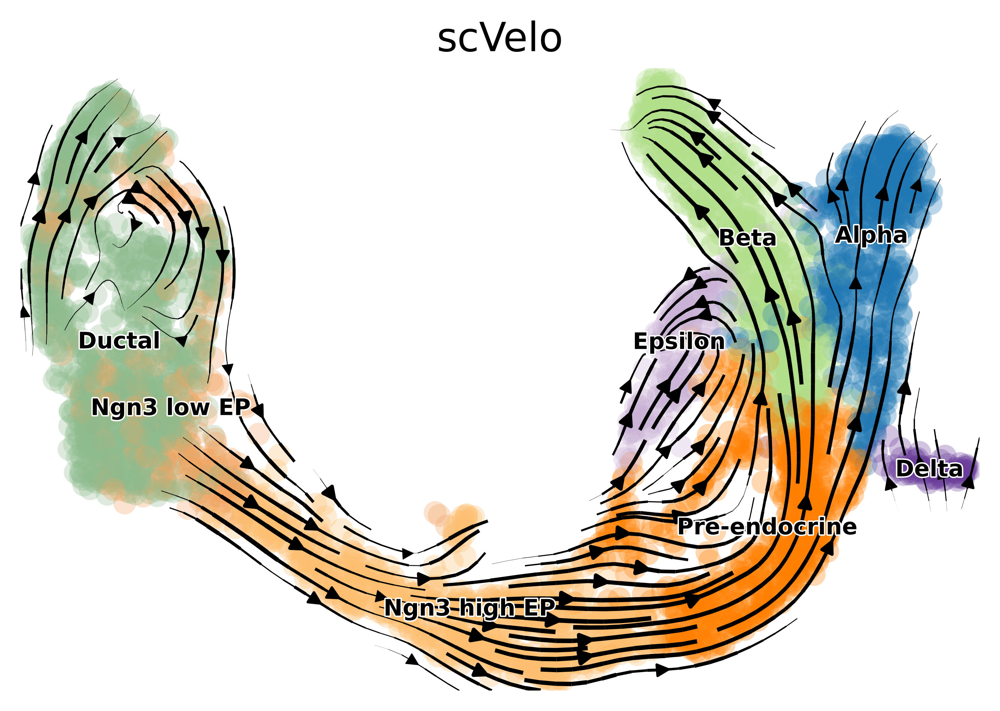

In [27]:
scv.pl.velocity_embedding_stream(scvelo_adata, color = "clusters", title = "scVelo", fontsize = 14, dpi = 300, save = "figure/scvelo_pancreas_velocity.png")

## DeepVelo

saving figure to file figure/deepvelo_pancreas_velocity.png


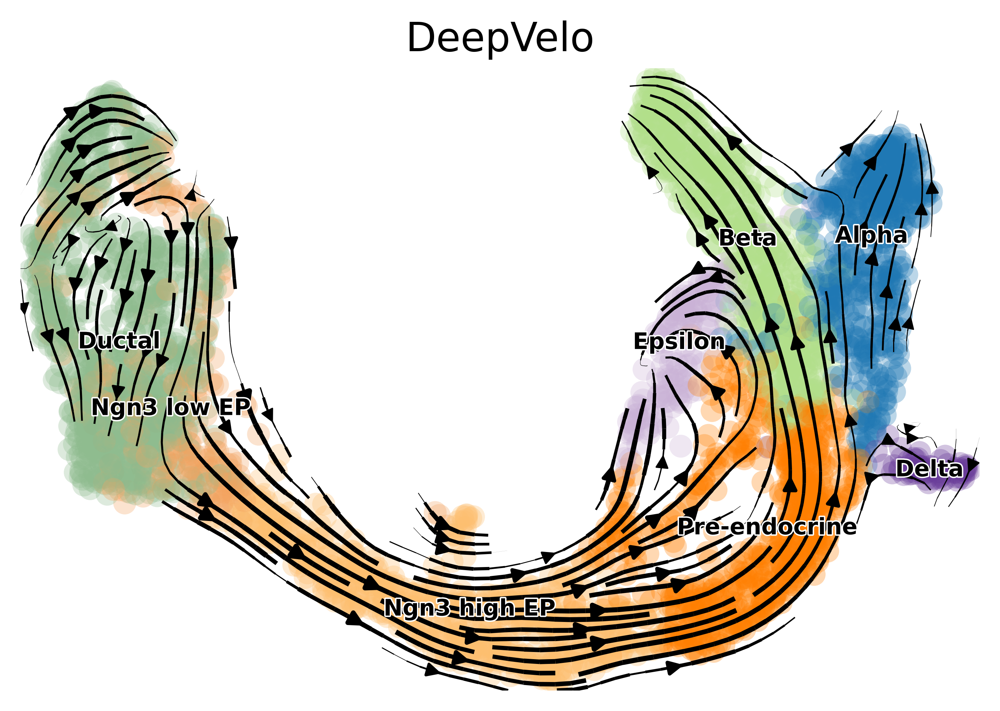

In [28]:
scv.pl.velocity_embedding_stream(deepvelo_adata, color = "clusters", title = "DeepVelo", fontsize = 14, dpi = 300, save = "figure/deepvelo_pancreas_velocity.png")

## celldancer

saving figure to file figure/celldancer_pancreas_velocity.png


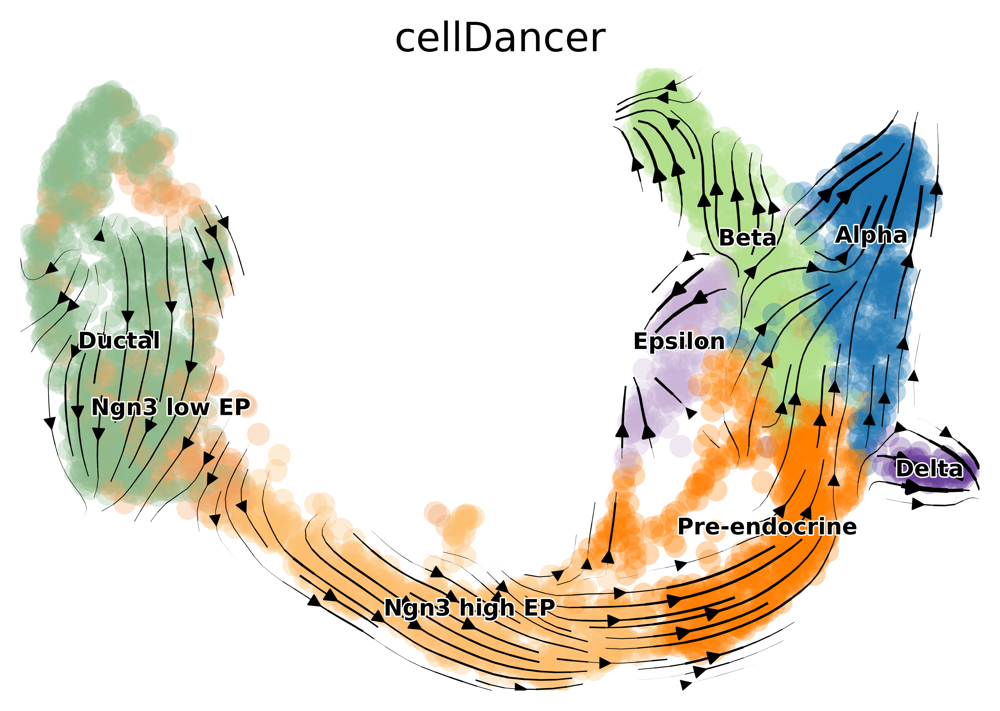

In [6]:
scv.pl.velocity_embedding_stream(celldancer_adata, color = "clusters", title = "cellDancer", fontsize = 14, dpi = 300, save = "figure/celldancer_pancreas_velocity.png", basis = "cdr", vkey = "velocity")

## JuloVelo

saving figure to file figure/julovelo_pancreas_velocity.png


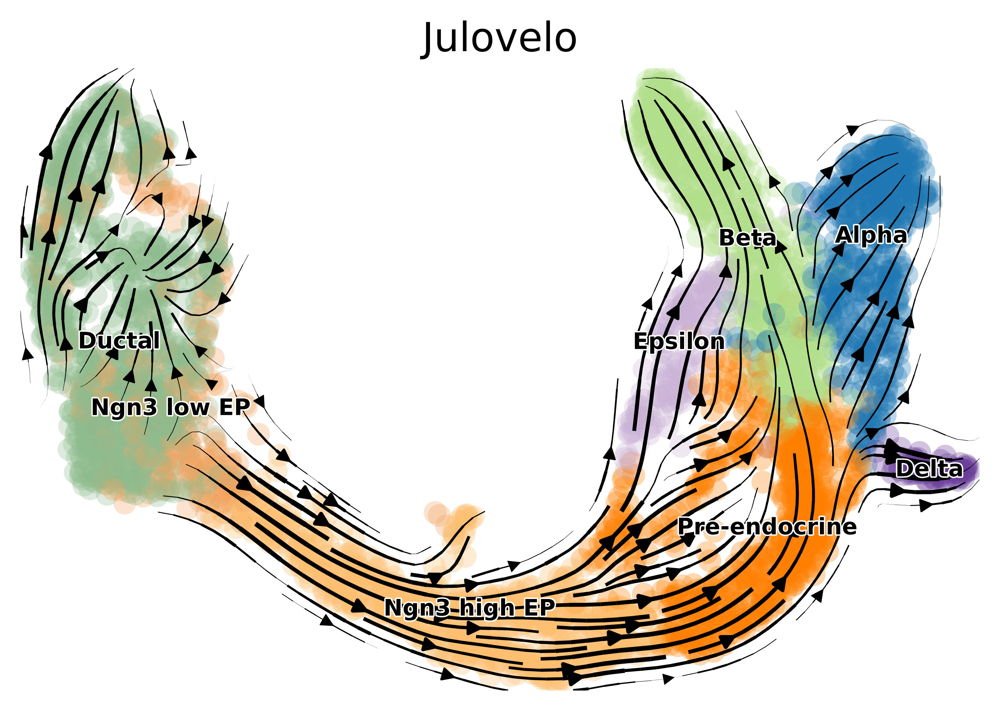

In [41]:
scv.pl.velocity_embedding_stream(julovelo_adata, color = "clusters", title = "Julovelo", fontsize = 14, dpi = 300, save = "figure/julovelo_pancreas_velocity.png", basis = "ebd", vkey = "velocity")

# Pseudotime

## ScVelo 

saving figure to file figure/scvelo_pancreas_pseudotime.png


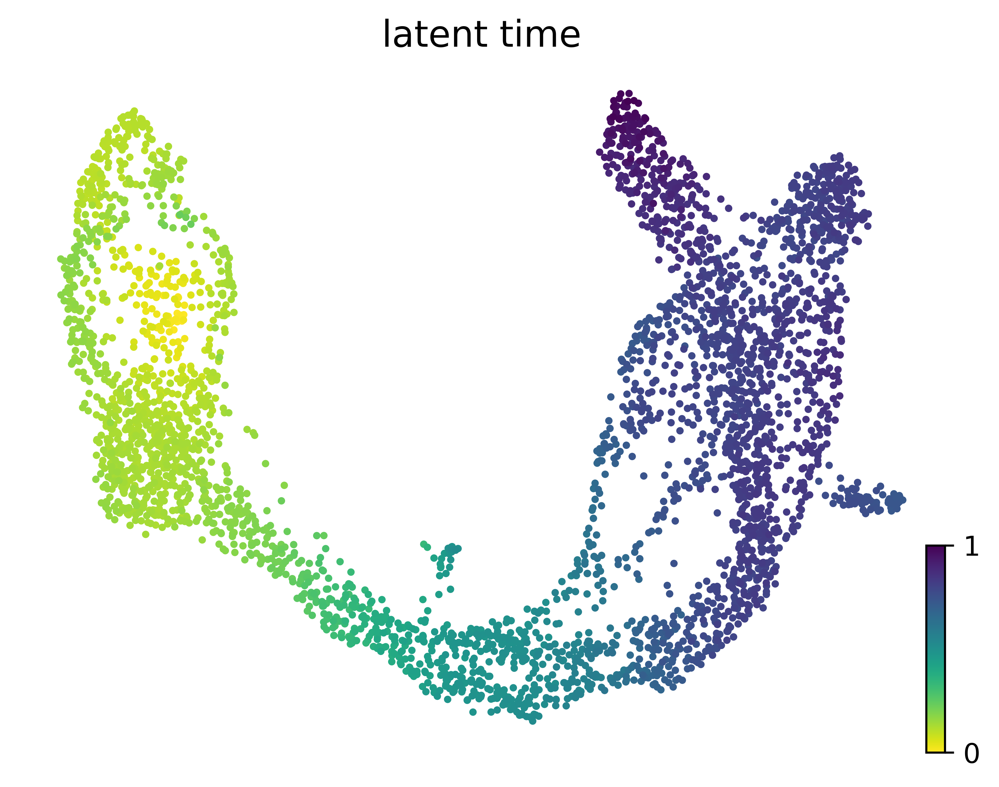

In [8]:
scv.pl.scatter(scvelo_adata, basis = "umap", color = "latent_time", fontsize = 14, dpi = 300, save = "figure/scvelo_pancreas_pseudotime.png")

## DeepVelo

saving figure to file figure/deepvelo_pancreas_pseudotime.png


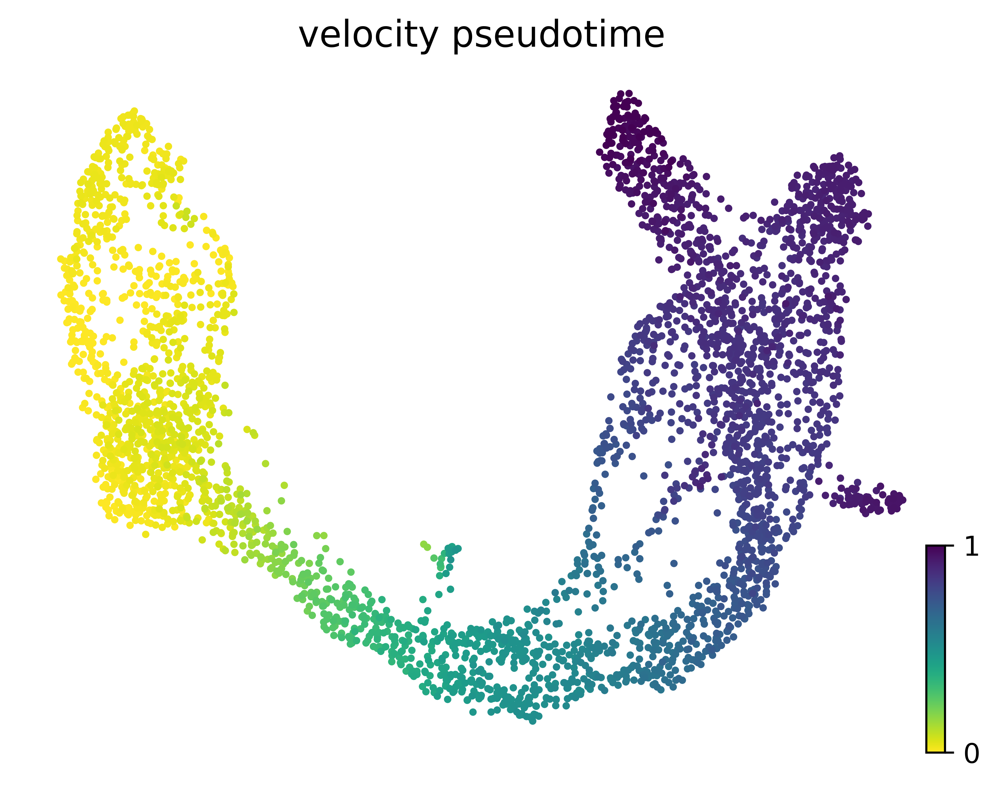

In [9]:
scv.pl.scatter(deepvelo_adata, basis = "umap", color = "velocity_pseudotime", fontsize = 14, dpi = 300, save = "figure/deepvelo_pancreas_pseudotime.png")

## celldancer

saving figure to file figure/celldancer_pancreas_pseudotime.png


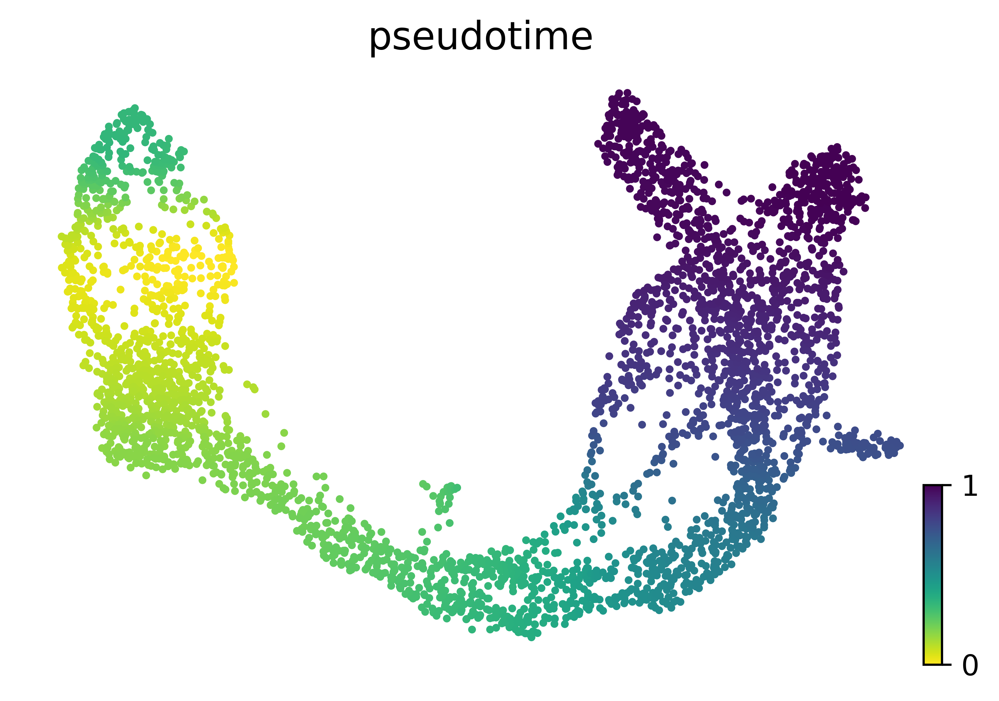

In [7]:
scv.pl.scatter(celldancer_adata, basis = "cdr", color = "pseudotime", fontsize = 14, dpi = 300, save = "figure/celldancer_pancreas_pseudotime.png")

## JuloVelo

saving figure to file figure/julovelo_pancreas_pseudotime.png


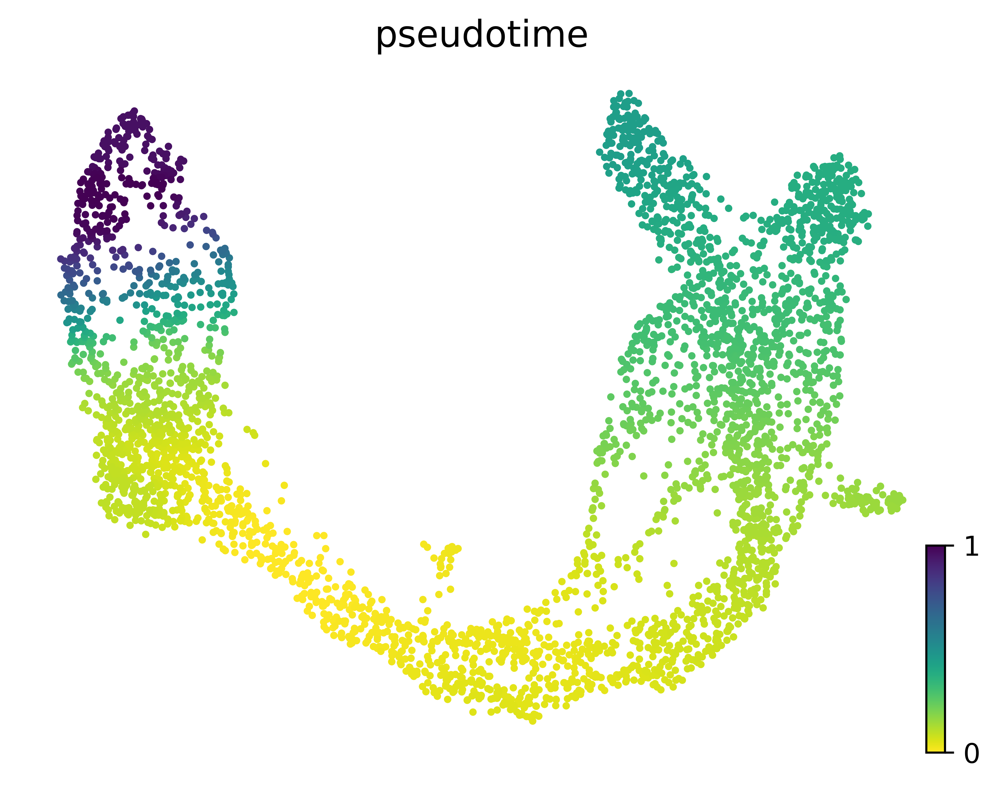

In [7]:
scv.pl.scatter(julovelo_adata, basis = "ebd", color = "pseudotime", fontsize = 14, dpi = 300, save = "figure/julovelo_pancreas_pseudotime.png")

# Heatmap

In [42]:
p1, p2 = plotting_sort(julovelo_adata, "M_u", "alpha", n_convolve = 200, col_color = "clusters", save = True, save_path = "figure/")

In [6]:
p1, p2 = plotting_sort(julovelo_adata, "M_s", "alpha", n_convolve = 200, col_color = "clusters", save = True, save_path = "figure/")

# Expression

In [3]:
genes = ["Actn4", "Pax4", "Slc2a2"]

saving figure to file figure/embedding_pancreas_spliced_pattern.png


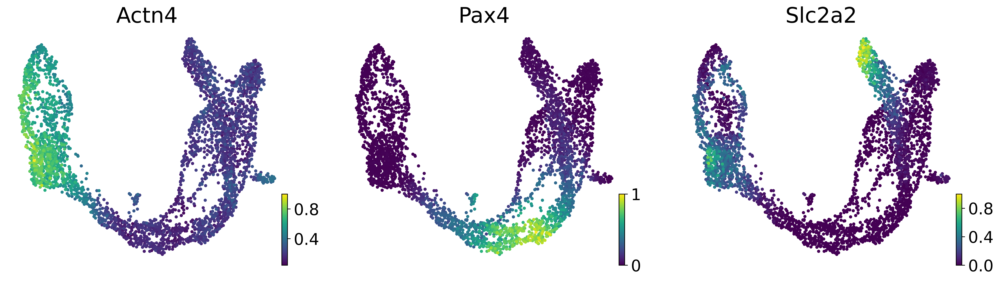

In [7]:
scv.pl.scatter(julovelo_adata, color = genes, basis = "ebd", size = 50, fontsize = 24, save = "figure/embedding_pancreas_spliced_pattern.png", dpi = 300)

In [51]:
julovelo_adata.var_names

Index(['Sntg1', 'Ncoa2', 'Sbspon', 'Mcm3', 'Fam135a', 'Adgrb3', 'Tbc1d8',
       'Fhl2', 'Pgap1', 'Ankrd44',
       ...
       'Wnk3', 'Rragb', 'Sh3kbp1', 'Map3k15', 'Rai2', 'Rbbp7', 'Ap1s2',
       'Tmem27', 'Uty', 'Eif2s3y'],
      dtype='object', length=1391)

# Cell cycle

In [15]:
scv.tl.score_genes_cell_cycle(julovelo_adata)

calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


saving figure to file figure/embedding_pancreas_cell_cycle.png


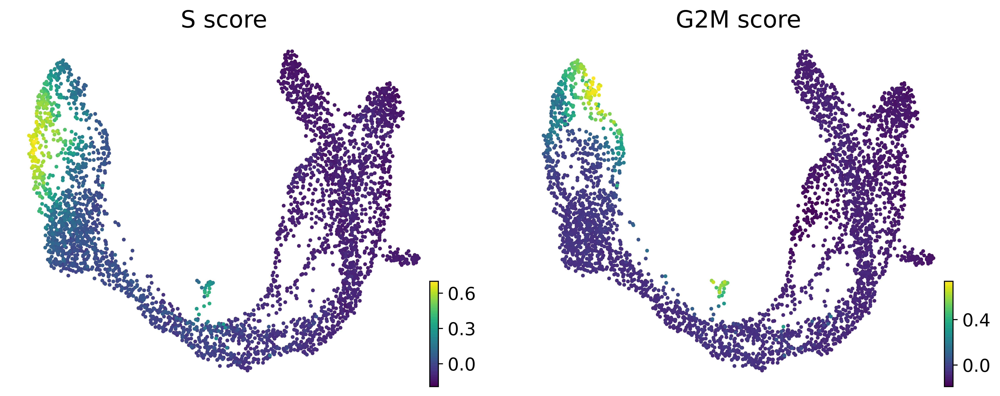

In [16]:
scv.pl.scatter(julovelo_adata, basis = "ebd", color = ["S_score", "G2M_score"], fontsize = 18, save = "figure/embedding_pancreas_cell_cycle.png", dpi = 300)